!pip3 install plotly
!pip3 install nbformat
!pip install -q catboost 
!pip install -q lightgbm
!pip install seaborn

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime 

#plot
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
%matplotlib inline

#modle
import time
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn import metrics
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score

In [2]:
#load the data
data= pd.read_csv("2010to2017nsWithoutNA.csv")
#data = data[100000:]

In [3]:
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag
0,15.0,9.65706,53.57080,12.0,20100121.0,3.0,0.0005,33.658676,0.0
1,15.0,9.65226,53.57170,11.0,20100121.0,3.0,0.0026,33.658894,0.0
2,15.0,9.64802,53.57256,13.0,20100121.0,3.0,0.0015,33.658823,0.0
3,15.0,9.64354,53.57392,12.0,20100121.0,3.0,0.0018,33.658896,0.0
4,15.0,9.63918,53.57548,13.0,20100121.0,3.0,0.0010,33.658877,0.0
...,...,...,...,...,...,...,...,...,...
220607,7.0,355.97763,49.09174,0.0,20150111.0,3.5,14.0350,35.358181,0.0
220608,7.0,355.97485,49.09552,0.0,20150111.0,3.5,14.0310,35.358089,0.0
220609,7.0,355.97018,49.10169,0.0,20150111.0,3.5,14.0280,35.356300,0.0
220610,7.0,355.96609,49.10715,0.0,20150111.0,3.5,14.0340,35.356022,0.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220612 entries, 0 to 220611
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   time         220612 non-null  float64
 1   Longitude    220612 non-null  float64
 2   Latitude     220612 non-null  float64
 3   botDepth     220612 non-null  float64
 4   date         220612 non-null  float64
 5   depth        220612 non-null  float64
 6   temperature  220612 non-null  float64
 7   salinity     220612 non-null  float64
 8   qualityflag  220612 non-null  float64
dtypes: float64(9)
memory usage: 15.1 MB


## Transfer time formats

In [5]:
data['date']=data['date'].round(0).astype("int").astype("string")
data['time']=data['time'].round(0).astype("int").astype("string")
data['qualityflag']=data['qualityflag'].round(0).astype("int")
# data['qualityflag']=data['qualityflag'].round(0).astype("int").astype("string")
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag
0,15,9.65706,53.57080,12.0,20100121,3.0,0.0005,33.658676,0
1,15,9.65226,53.57170,11.0,20100121,3.0,0.0026,33.658894,0
2,15,9.64802,53.57256,13.0,20100121,3.0,0.0015,33.658823,0
3,15,9.64354,53.57392,12.0,20100121,3.0,0.0018,33.658896,0
4,15,9.63918,53.57548,13.0,20100121,3.0,0.0010,33.658877,0
...,...,...,...,...,...,...,...,...,...
220607,7,355.97763,49.09174,0.0,20150111,3.5,14.0350,35.358181,0
220608,7,355.97485,49.09552,0.0,20150111,3.5,14.0310,35.358089,0
220609,7,355.97018,49.10169,0.0,20150111,3.5,14.0280,35.356300,0
220610,7,355.96609,49.10715,0.0,20150111,3.5,14.0340,35.356022,0


In [6]:
data['datetime'] = pd.to_datetime(data['date'].str.cat(data['time'], sep = ':'), format= '%Y%m%d:%H')
data.sort_values("datetime", ascending=True, inplace=True)
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag,datetime
128084,0,358.94821,55.60880,0.0,20100114,3.5,6.4320,34.665810,0,2010-01-14 00:00:00
125653,0,3.43159,53.00650,0.0,20100114,3.5,5.6820,34.784801,0,2010-01-14 00:00:00
124334,0,2.66470,51.80500,0.0,20100114,3.5,6.6440,34.866791,0,2010-01-14 00:00:00
124335,0,2.65100,51.81740,0.0,20100114,3.5,6.6400,34.883789,0,2010-01-14 00:00:00
124336,0,2.63139,51.83490,0.0,20100114,3.5,6.7640,34.892792,0,2010-01-14 00:00:00
...,...,...,...,...,...,...,...,...,...,...
108502,23,6.75610,54.98440,30.0,20150310,3.0,5.7161,34.080087,0,2015-03-10 23:00:00
108503,23,6.75622,54.98450,30.0,20150310,3.0,5.7135,34.079856,0,2015-03-10 23:00:00
108504,23,6.75603,54.98441,30.0,20150310,3.0,5.7198,34.080419,0,2015-03-10 23:00:00
107779,23,8.07243,54.75209,8.0,20150310,3.0,5.0479,34.012564,0,2015-03-10 23:00:00


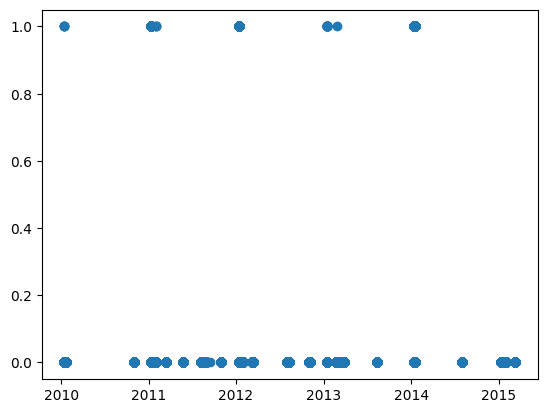

In [7]:
plt.scatter(data.datetime, data.qualityflag)
plt.show()

In [8]:
data = data.drop(['time', 'date'], axis=1)
data["datetime"] = data["datetime"].apply(lambda x: x.timestamp())
cols = ['datetime','Longitude','Latitude','botDepth','depth','temperature','salinity','qualityflag']
data = data.reindex(columns=cols)
data

,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
128084,1.263427e+09,358.94821,55.60880,0.0,3.5,6.4320,34.665810,0
125653,1.263427e+09,3.43159,53.00650,0.0,3.5,5.6820,34.784801,0
124334,1.263427e+09,2.66470,51.80500,0.0,3.5,6.6440,34.866791,0
124335,1.263427e+09,2.65100,51.81740,0.0,3.5,6.6400,34.883789,0
124336,1.263427e+09,2.63139,51.83490,0.0,3.5,6.7640,34.892792,0
...,...,...,...,...,...,...,...,...
108502,1.426028e+09,6.75610,54.98440,30.0,3.0,5.7161,34.080087,0
108503,1.426028e+09,6.75622,54.98450,30.0,3.0,5.7135,34.079856,0
108504,1.426028e+09,6.75603,54.98441,30.0,3.0,5.7198,34.080419,0
107779,1.426028e+09,8.07243,54.75209,8.0,3.0,5.0479,34.012564,0


## Z-score normalization 

In [24]:
cl=len(cols)-1
df=data.copy()
for i in range(0,cl):
    mean = data.iloc[:,i].mean()
    std = np.std(data.iloc[:,i])
    df.iloc[:,i] = data.iloc[:,i].apply(lambda x: (x - mean) / std)
    
print(df)
print(data)

        datetime  Longitude  Latitude  botDepth     depth  temperature  \
128084 -1.732023   2.099265  0.752209 -0.381173  0.693024    -0.784248   
125653 -1.732023  -0.486042 -0.297482 -0.381173  0.693024    -0.929445   
124334 -1.732023  -0.491618 -0.782132 -0.381173  0.693024    -0.743205   
124335 -1.732023  -0.491718 -0.777130 -0.381173  0.693024    -0.743980   
124336 -1.732023  -0.491861 -0.770071 -0.381173  0.693024    -0.719974   
...          ...        ...       ...       ...       ...          ...   
108502  1.562493  -0.461866  0.500345  0.031783 -0.216042    -0.922844   
108503  1.562493  -0.461865  0.500385  0.031783 -0.216042    -0.923347   
108504  1.562493  -0.461866  0.500349  0.031783 -0.216042    -0.922127   
107779  1.562493  -0.452294  0.406638 -0.271052 -0.216042    -1.052205   
109978  1.562493  -0.466691  0.207921  0.100609 -0.216042    -0.881337   

        salinity  qualityflag  
128084  0.076151            0  
125653  0.159934            0  
124334  0.21766

In [25]:
data=df
#data.to_csv('data.csv', index=False)

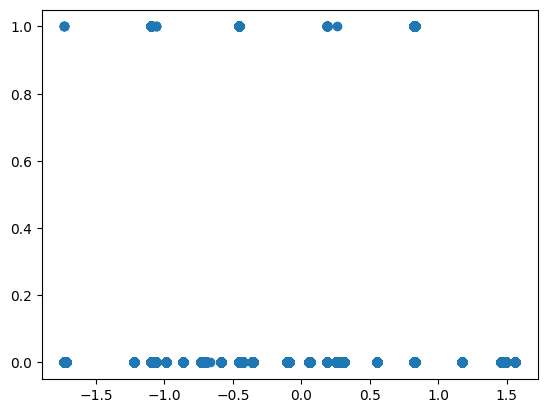

In [27]:
plt.scatter(data.datetime, data.qualityflag)
plt.show()

In [28]:
instance = data[(data['qualityflag']==1)]
rate=len(instance)/len(data)*100
print(rate)

0.6948851377078309


In [29]:
def plotCluster(data,name1,name2,name3,label,start,end):   

    data1=data.loc[data[label] == 1]
    #print(data1)

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  # [ 0  3  6  9 12 15 18 21]
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  # [ 1  4  7 10 13 16 19 22]
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  # [ 2  5  8 11 14 17 20 23]


    data2=data.loc[data[label] == 0]
    #print(data2)

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  # [ 0  3  6  9 12 15 18 21]
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  # [ 1  4  7 10 13 16 19 22]
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  # [ 2  5  8 11 14 17 20 23]

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    #ax = Axes3D(fig)
    ax.scatter(x1, y1, z1, c='r',s=10, label='Abnormal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='Normal Data')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('scatter.png')
    
    #violin
    fig = px.violin(data, y=name1,color=label)
    fig.show()
    fig = px.violin(data, y=name2,color=label)
    fig.show()
    fig = px.violin(data, y=name3,color=label)
    fig.show()
    


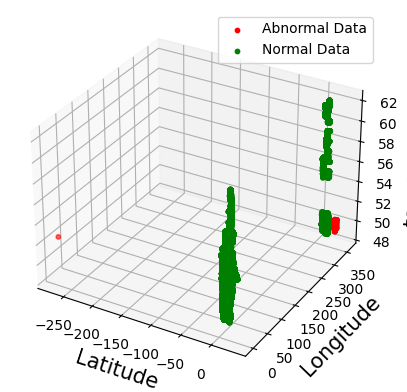

<Figure size 640x480 with 0 Axes>

In [13]:
dataplot=data.copy()
#dataplot['qualityflag']=y
#plot 3D figure by any three features

plotCluster(dataplot,'temperature','Longitude','Latitude','qualityflag',0,data.shape[0])

## test set
### random 10%  
test1
### and  last 10%
test2

In [30]:
#split the data and make sure the proportion in train and test set are equal
def getRandomSplit(data, size):
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.model_selection import train_test_split
    train_set, test_set = train_test_split(data, test_size = size,random_state = 42)
#    split = StratifiedShuffleSplit(n_splits = 1,test_size = size,random_state = 42)

#     for train_index,test_index in split.split(data,data.iloc[:,-1]):
#         train_set = data.iloc[train_index,:]
#         test_set = data.iloc[test_index,:]

    print(len(train_set),len(test_set))
    return train_set,test_set
    

In [31]:
#split the last 10% data 

# window
def sliding_window(data, window_size):
    # from last raw
    for i in range(len(data)-1, window_size-2, -1):
        data_slice = data[i-window_size+1:i+1]
        ratio = (data_slice["qualityflag"] == 1).sum() / window_size*100
        #print(ratio)
        if rate*0.9 <= ratio <= rate*1.1:
            #print(data_slice)
            return data_slice



def getLastSplit(data, size):
    data.sort_values("datetime", ascending=True, inplace=True)
    print(data)
    row,col=data.shape
    window_size = int(size*row)
    test_set=sliding_window(data, window_size)
    time = test_set.iloc[0,0]
    #print(time)
    train_set = data[data['datetime'] < time]
    print(len(train_set),len(test_set))
    return train_set,test_set
# windows keep the same rate of anomaly

In [32]:
#sampling
train_set1,test_set1 = getRandomSplit(data,0.1)
train_set2,test_set2 = getLastSplit(data,0.1)

198550 22062
        datetime  Longitude  Latitude  botDepth     depth  temperature  \
128084 -1.732023   2.099265  0.752209 -0.381173  0.693024    -0.784248   
125932 -1.732023  -0.490592  0.039131 -0.381173  0.693024    -1.019661   
126743 -1.732023  -0.457810  0.780163 -0.381173  0.693024    -1.654079   
125933 -1.732023  -0.490631  0.047480 -0.381173  0.693024    -1.027018   
127564 -1.732023  -0.498074  0.847768 -0.381173  0.693024    -0.763533   
...          ...        ...       ...       ...       ...          ...   
109975  1.562493  -0.466781  0.207832  0.100609 -0.216042    -0.881627   
109976  1.562493  -0.466752  0.207869  0.086843 -0.216042    -0.881085   
109977  1.562493  -0.466721  0.207873  0.086843 -0.216042    -0.881317   
107777  1.562493  -0.452293  0.406569 -0.271052 -0.216042    -1.057432   
109978  1.562493  -0.466691  0.207921  0.100609 -0.216042    -0.881337   

        salinity  qualityflag  
128084  0.076151            0  
125932 -0.038625            0  
12

In [33]:
train_set1 = train_set1.sample(n=167516)
#print(train_set1.shape)

In [34]:
train_set1.head()
test_set1.head()

,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
181235,0.826375,-0.453771,0.126424,-0.381173,0.693024,-1.031665,-1.354000,0
170983,0.826156,-0.508014,-1.560770,-0.381173,0.693024,-0.223978,-1.245229,0
58458,-0.698379,-0.457168,0.092904,-0.037043,-0.216042,1.429146,0.487046,0
182237,0.826229,-0.480467,0.431590,-0.381173,0.693024,-0.802059,0.127179,0
197371,1.460011,-0.505773,-1.474030,-0.381173,0.693024,-0.203263,-0.701899,0


In [35]:
instance = test_set1[(test_set1['qualityflag']==1)]
rate=len(instance)/len(test_set1)*100
print(rate)

0.7161635391170338


In [36]:
print(test_set2)

        datetime  Longitude  Latitude  botDepth     depth  temperature  \
182448  0.826886  -0.484032  0.510102 -0.381173  0.693024    -0.845812   
182447  0.826886  -0.484061  0.511619 -0.381173  0.693024    -0.846586   
182446  0.826886  -0.484095  0.513374 -0.381173  0.693024    -0.847167   
182445  0.826886  -0.484140  0.515588 -0.381173  0.693024    -0.846973   
182444  0.826886  -0.484168  0.517060 -0.381173  0.693024    -0.847360   
...          ...        ...       ...       ...       ...          ...   
215723  1.459501   2.103413 -1.596840 -0.381173  0.693024     1.198572   
210602  1.459501  -0.496528 -0.760657 -0.381173  0.693024    -0.649891   
201556  1.459501  -0.453508  0.261416 -0.381173  0.693024    -1.157502   
210600  1.459501  -0.496455 -0.759442 -0.381173  0.693024    -0.647375   
216924  1.459501   2.105048 -1.214687 -0.381173  0.693024     1.083575   

        salinity  qualityflag  
182448  0.154793            1  
182447  0.157962            1  
182446  0.21585

In [37]:
print(train_set2)

        datetime  Longitude  Latitude  botDepth     depth  temperature  \
128084 -1.732023   2.099265  0.752209 -0.381173  0.693024    -0.784248   
125932 -1.732023  -0.490592  0.039131 -0.381173  0.693024    -1.019661   
126743 -1.732023  -0.457810  0.780163 -0.381173  0.693024    -1.654079   
125933 -1.732023  -0.490631  0.047480 -0.381173  0.693024    -1.027018   
127564 -1.732023  -0.498074  0.847768 -0.381173  0.693024    -0.763533   
...          ...        ...       ...       ...       ...          ...   
172938  0.826813  -0.506600 -1.293796 -0.381173  0.693024    -0.001729   
172937  0.826813  -0.506547 -1.292194 -0.381173  0.693024    -0.001148   
172936  0.826813  -0.506499 -1.290722 -0.381173  0.693024    -0.001148   
171191  0.826813  -0.502487 -1.434588 -0.381173  0.693024    -0.252050   
171183  0.826813  -0.502430 -1.437000 -0.381173  0.693024    -0.246435   

        salinity  qualityflag  
128084  0.076151            0  
125932 -0.038625            0  
126743 -0.39348

In [38]:
instance = test_set2[(test_set2['qualityflag']==1)]
rate=len(instance)/len(test_set2)*100
print(rate)

0.6527355967544535


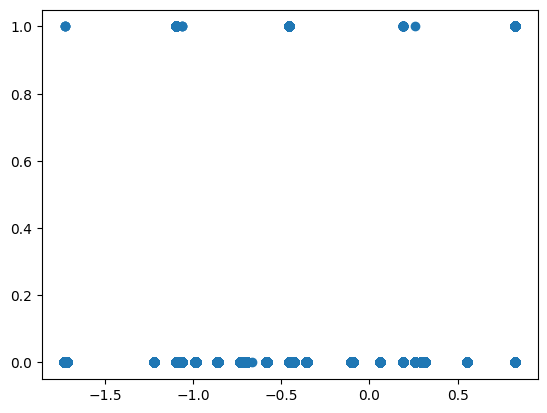

In [39]:
plt.scatter(train_set2.datetime, train_set2.qualityflag)
plt.show()

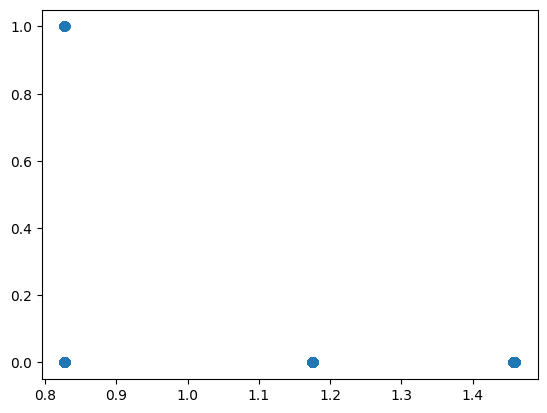

In [40]:
plt.scatter(test_set2.datetime, test_set2.qualityflag)
plt.show()

## supervised ml

In [41]:
params = {'num_leaves': 60, 
          'min_data_in_leaf': 30,
          'objective': 'binary', 
          'max_depth': -1,
          'learning_rate': 0.03,
          "min_sum_hessian_in_leaf": 6,
          "boosting": "gbdt",
          "feature_fraction": 0.9,
          "bagging_freq": 1,
          "bagging_fraction": 0.8,
          "bagging_seed": 11,
          "verbosity": -1,
          "random_state": 2019,
          }




In [26]:
lgb_params = {
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'n_estimators': 100000,
    'learning_rate': 0.1,
    'random_state': 2948,
    'bagging_freq': 8,
    'bagging_fraction': 0.80718,
    'feature_fraction': 0.7,  # 0.3
    'feature_fraction_seed': 11,
    'max_depth': 9,
    'min_data_in_leaf': 40,
    'min_child_weight': 0.18654,
    "min_split_gain": 0.35079,
    'min_sum_hessian_in_leaf': 1.11347,
    'num_leaves': 29,
    'num_threads': 4,
    "lambda_l1": 0.55831,
    'lambda_l2': 1.67906,
    'cat_smooth': 10.4,
    'subsample': 0.7,
    'colsample_bytree': 0.7,
    'n_jobs': -1,
    'metric': 'auc'
}

In [42]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre)
    recall=recall_score(y_tru,y_pre)
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre)
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("balanced acc:",bac)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    
    # confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})

In [28]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf1 = model

    param_dist = dist
    grid = RandomizedSearchCV(clf1,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [43]:
def classSuper(train_set,test_set):
    x,y=data.shape
    score=[]
    models=[]
    # fit model and predict
    
    
    ##lightgbm
    print("lightgbm")
    clf1 = lgb.LGBMClassifier()
    clf1 = clf1.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre1=clf1.predict(test_set.iloc[:,0:y-1])
    y_tru1=test_set.iloc[:,y-1]
    computeMetric(y_tru1,y_pre1)
    
    
    
    
    ## GradientBoosting
    print("GradientBoosting")
    from sklearn.ensemble import GradientBoostingClassifier
    clf2 = GradientBoostingClassifier()
    clf2.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre2 = clf2.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre2)
    
    ##catboost
    print("catboost")
    clf3 = CatBoostClassifier(loss_function='Logloss')
    clf3.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre3 = clf3.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre3)

    
    
    
    #KNN
    print("KNN")
    from sklearn.neighbors import KNeighborsClassifier
    clf4 = KNeighborsClassifier()
    dic4={'n_neighbors':[1,2,3,4,5,6,7,8,9]}
    #para11=getPar(clf11,dic11,p_set,10)
    clf4 = KNeighborsClassifier(n_jobs=-1)
    clf4.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])

    y_pre4=clf4.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre4)
    
#     #MLP
#     print("MLP")
#     from sklearn.neural_network import MLPClassifier
#     clf5 = MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(5, 2), random_state=1)
#     clf5.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
#     y_pre5 = clf5.predict(test_set.iloc[:,0:y-1])
#     computeMetric(y_tru1,y_pre5)
   



## random

lightgbm
acc: 0.9992294442933551
balanced acc: 0.9587694519699309
precision: 0.9731543624161074
recall: 0.9177215189873418
cm: [[21900     4]
 [   13   145]]
f1: 0.9446254071661238
MCC: 0.9446494865185454
Kappa: 0.9442377656687903
GradientBoosting
acc: 0.9976883328800653
balanced acc: 0.8543162453421604
precision: 0.9572649572649573
recall: 0.7088607594936709
cm: [[21899     5]
 [   46   112]]
f1: 0.8145454545454547
MCC: 0.8227172365372939
Kappa: 0.8134083837721502
catboost
Learning rate set to 0.09175
0:	learn: 0.4455658	total: 74.3ms	remaining: 1m 14s
1:	learn: 0.2632218	total: 90.3ms	remaining: 45.1s
2:	learn: 0.1605264	total: 106ms	remaining: 35.2s
3:	learn: 0.1069438	total: 115ms	remaining: 28.7s
4:	learn: 0.0720122	total: 129ms	remaining: 25.6s
5:	learn: 0.0511564	total: 142ms	remaining: 23.5s
6:	learn: 0.0383240	total: 155ms	remaining: 21.9s
7:	learn: 0.0309063	total: 167ms	remaining: 20.7s
8:	learn: 0.0255316	total: 180ms	remaining: 19.8s
9:	learn: 0.0215727	total: 194ms	remain

161:	learn: 0.0030609	total: 2.14s	remaining: 11.1s
162:	learn: 0.0030352	total: 2.15s	remaining: 11s
163:	learn: 0.0030282	total: 2.17s	remaining: 11s
164:	learn: 0.0030205	total: 2.18s	remaining: 11s
165:	learn: 0.0030046	total: 2.19s	remaining: 11s
166:	learn: 0.0029935	total: 2.2s	remaining: 11s
167:	learn: 0.0029806	total: 2.21s	remaining: 11s
168:	learn: 0.0029705	total: 2.23s	remaining: 10.9s
169:	learn: 0.0029342	total: 2.24s	remaining: 10.9s
170:	learn: 0.0029259	total: 2.25s	remaining: 10.9s
171:	learn: 0.0029091	total: 2.27s	remaining: 10.9s
172:	learn: 0.0028824	total: 2.28s	remaining: 10.9s
173:	learn: 0.0028711	total: 2.29s	remaining: 10.9s
174:	learn: 0.0028546	total: 2.3s	remaining: 10.9s
175:	learn: 0.0028531	total: 2.32s	remaining: 10.8s
176:	learn: 0.0028348	total: 2.33s	remaining: 10.8s
177:	learn: 0.0028282	total: 2.34s	remaining: 10.8s
178:	learn: 0.0028135	total: 2.36s	remaining: 10.8s
179:	learn: 0.0027837	total: 2.37s	remaining: 10.8s
180:	learn: 0.0027587	tota

327:	learn: 0.0015332	total: 4.21s	remaining: 8.64s
328:	learn: 0.0015298	total: 4.23s	remaining: 8.62s
329:	learn: 0.0015266	total: 4.24s	remaining: 8.61s
330:	learn: 0.0015103	total: 4.25s	remaining: 8.6s
331:	learn: 0.0015072	total: 4.26s	remaining: 8.58s
332:	learn: 0.0015042	total: 4.28s	remaining: 8.57s
333:	learn: 0.0015014	total: 4.29s	remaining: 8.55s
334:	learn: 0.0014984	total: 4.3s	remaining: 8.54s
335:	learn: 0.0014957	total: 4.31s	remaining: 8.52s
336:	learn: 0.0014936	total: 4.32s	remaining: 8.51s
337:	learn: 0.0014924	total: 4.34s	remaining: 8.49s
338:	learn: 0.0014870	total: 4.35s	remaining: 8.48s
339:	learn: 0.0014835	total: 4.36s	remaining: 8.46s
340:	learn: 0.0014824	total: 4.37s	remaining: 8.45s
341:	learn: 0.0014798	total: 4.38s	remaining: 8.43s
342:	learn: 0.0014775	total: 4.39s	remaining: 8.42s
343:	learn: 0.0014730	total: 4.41s	remaining: 8.4s
344:	learn: 0.0014664	total: 4.42s	remaining: 8.39s
345:	learn: 0.0014648	total: 4.43s	remaining: 8.38s
346:	learn: 0.0

497:	learn: 0.0009583	total: 6.28s	remaining: 6.33s
498:	learn: 0.0009562	total: 6.29s	remaining: 6.31s
499:	learn: 0.0009550	total: 6.3s	remaining: 6.3s
500:	learn: 0.0009526	total: 6.31s	remaining: 6.29s
501:	learn: 0.0009487	total: 6.33s	remaining: 6.27s
502:	learn: 0.0009471	total: 6.34s	remaining: 6.26s
503:	learn: 0.0009471	total: 6.34s	remaining: 6.24s
504:	learn: 0.0009457	total: 6.36s	remaining: 6.23s
505:	learn: 0.0009440	total: 6.37s	remaining: 6.22s
506:	learn: 0.0009428	total: 6.38s	remaining: 6.2s
507:	learn: 0.0009424	total: 6.39s	remaining: 6.19s
508:	learn: 0.0009394	total: 6.4s	remaining: 6.18s
509:	learn: 0.0009386	total: 6.42s	remaining: 6.16s
510:	learn: 0.0009358	total: 6.43s	remaining: 6.15s
511:	learn: 0.0009309	total: 6.44s	remaining: 6.14s
512:	learn: 0.0009309	total: 6.45s	remaining: 6.12s
513:	learn: 0.0009292	total: 6.46s	remaining: 6.11s
514:	learn: 0.0009285	total: 6.48s	remaining: 6.1s
515:	learn: 0.0009259	total: 6.49s	remaining: 6.09s
516:	learn: 0.000

666:	learn: 0.0006737	total: 8.31s	remaining: 4.15s
667:	learn: 0.0006736	total: 8.32s	remaining: 4.14s
668:	learn: 0.0006727	total: 8.34s	remaining: 4.13s
669:	learn: 0.0006725	total: 8.35s	remaining: 4.11s
670:	learn: 0.0006723	total: 8.36s	remaining: 4.1s
671:	learn: 0.0006698	total: 8.37s	remaining: 4.09s
672:	learn: 0.0006690	total: 8.38s	remaining: 4.07s
673:	learn: 0.0006688	total: 8.4s	remaining: 4.06s
674:	learn: 0.0006687	total: 8.41s	remaining: 4.05s
675:	learn: 0.0006681	total: 8.42s	remaining: 4.04s
676:	learn: 0.0006679	total: 8.43s	remaining: 4.02s
677:	learn: 0.0006679	total: 8.44s	remaining: 4.01s
678:	learn: 0.0006642	total: 8.46s	remaining: 4s
679:	learn: 0.0006634	total: 8.47s	remaining: 3.98s
680:	learn: 0.0006616	total: 8.48s	remaining: 3.97s
681:	learn: 0.0006607	total: 8.49s	remaining: 3.96s
682:	learn: 0.0006598	total: 8.51s	remaining: 3.95s
683:	learn: 0.0006596	total: 8.52s	remaining: 3.94s
684:	learn: 0.0006596	total: 8.53s	remaining: 3.92s
685:	learn: 0.000

837:	learn: 0.0005506	total: 10.2s	remaining: 1.96s
838:	learn: 0.0005506	total: 10.2s	remaining: 1.95s
839:	learn: 0.0005506	total: 10.2s	remaining: 1.94s
840:	learn: 0.0005506	total: 10.2s	remaining: 1.92s
841:	learn: 0.0005506	total: 10.2s	remaining: 1.91s
842:	learn: 0.0005506	total: 10.2s	remaining: 1.9s
843:	learn: 0.0005506	total: 10.2s	remaining: 1.89s
844:	learn: 0.0005506	total: 10.2s	remaining: 1.87s
845:	learn: 0.0005506	total: 10.2s	remaining: 1.86s
846:	learn: 0.0005506	total: 10.2s	remaining: 1.85s
847:	learn: 0.0005506	total: 10.2s	remaining: 1.84s
848:	learn: 0.0005506	total: 10.3s	remaining: 1.82s
849:	learn: 0.0005506	total: 10.3s	remaining: 1.81s
850:	learn: 0.0005506	total: 10.3s	remaining: 1.8s
851:	learn: 0.0005506	total: 10.3s	remaining: 1.78s
852:	learn: 0.0005506	total: 10.3s	remaining: 1.77s
853:	learn: 0.0005499	total: 10.3s	remaining: 1.76s
854:	learn: 0.0005499	total: 10.3s	remaining: 1.75s
855:	learn: 0.0005499	total: 10.3s	remaining: 1.74s
856:	learn: 0.

acc: 0.9991841174870819
balanced acc: 0.9430379746835442
precision: 1.0
recall: 0.8860759493670886
cm: [[21904     0]
 [   18   140]]
f1: 0.9395973154362416
MCC: 0.940929539677519
Kappa: 0.9391881089749283


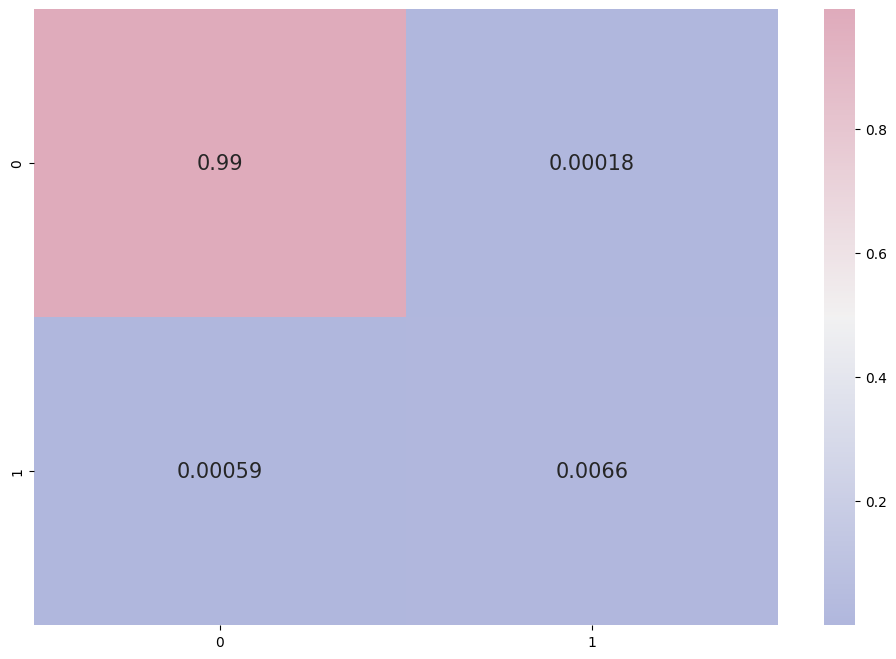

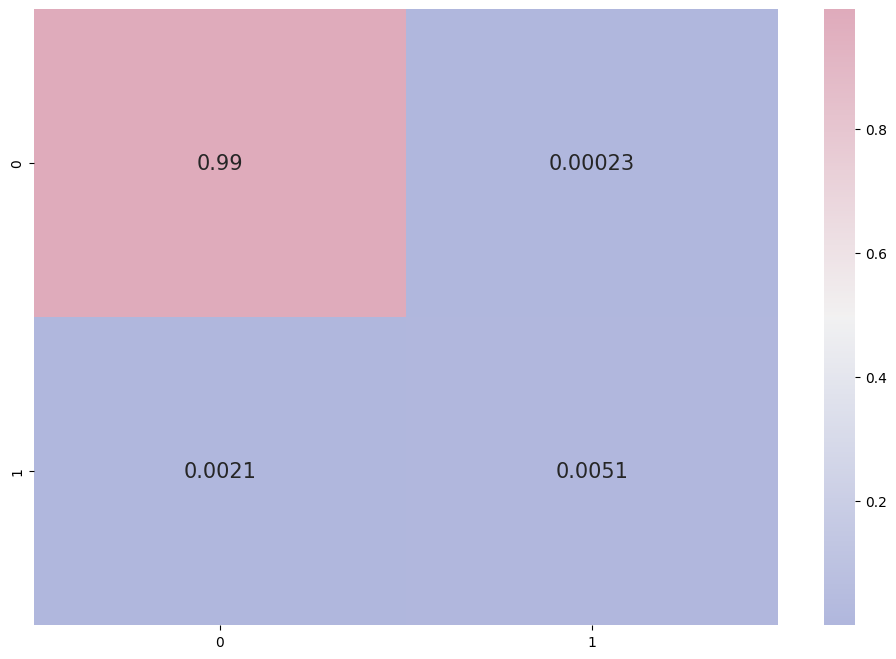

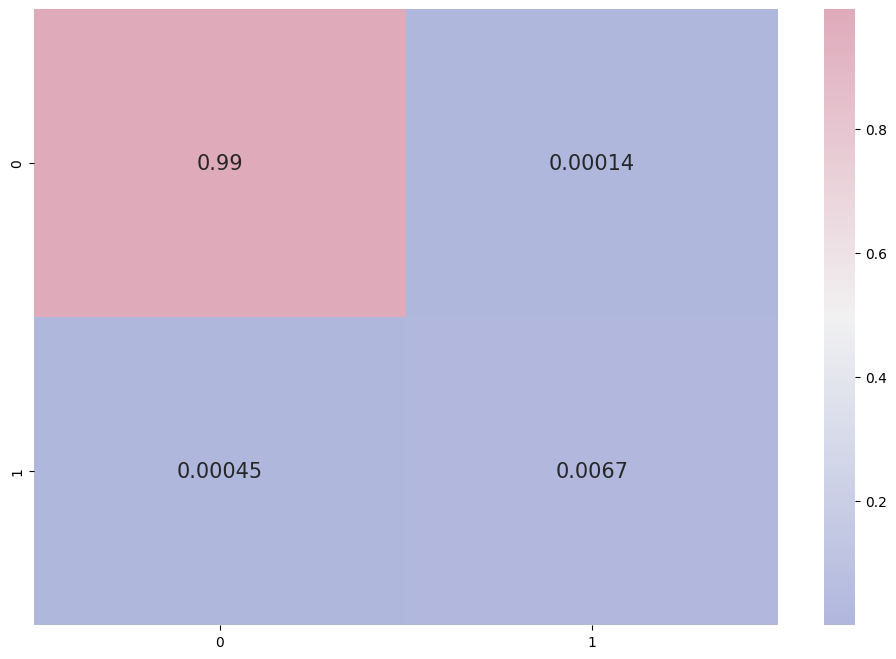

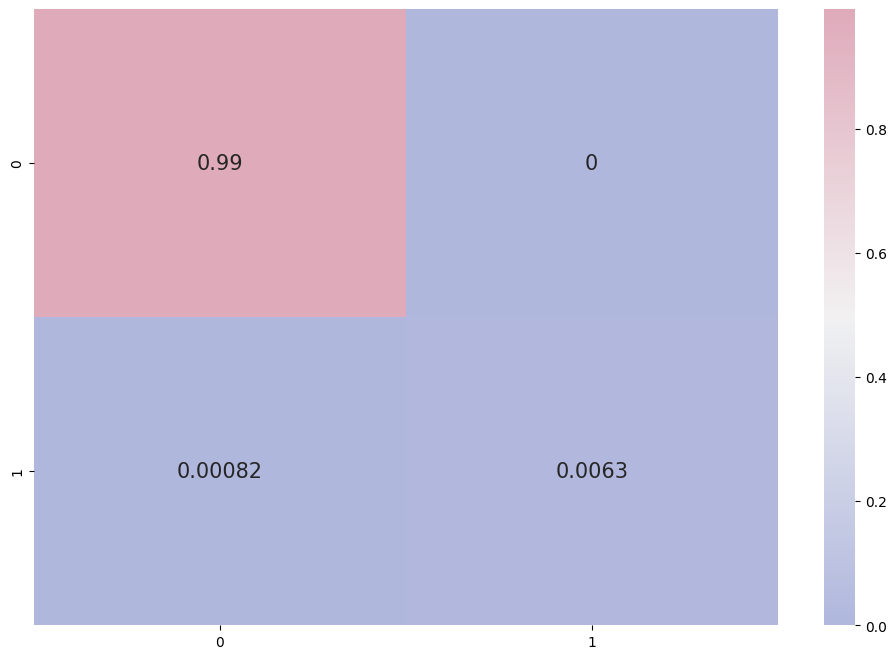

In [44]:
#random
classSuper(train_set1,test_set1)

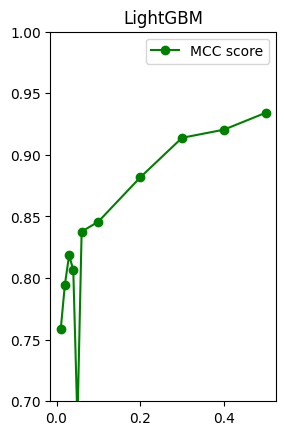

In [45]:
#learning curve
model = lgb.LGBMClassifier()
title1 = "LightGBM"
plt.subplot(121)
x,y=train_set1.shape
train_sizes=[0.01,0.02,0.03,0.04,0.05,0.06,0.1,0.2,0.3,0.4,0.5,]
mccList=[]
plt.title(title1)
ylim=[0.7,1.0]
if ylim is not None:
    plt.ylim(*ylim)
for size in train_sizes:
    train_set = train_set1.sample(frac=size)
    clf = model.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre=clf.predict(test_set1.iloc[:,0:y-1])
    y_tru=test_set1.iloc[:,y-1]
    #compute metric
    mcc=matthews_corrcoef(y_tru, y_pre)
    mccList.append(mcc)
        

plt.plot(train_sizes, mccList, "o-", color="green", label="MCC score")
plt.legend(loc="best")
plt.show()

## Last

error reason: some predict label type do not exist in training set.

In [46]:
print(train_set2)
print(test_set2)

        datetime  Longitude  Latitude  botDepth     depth  temperature  \
128084 -1.732023   2.099265  0.752209 -0.381173  0.693024    -0.784248   
125932 -1.732023  -0.490592  0.039131 -0.381173  0.693024    -1.019661   
126743 -1.732023  -0.457810  0.780163 -0.381173  0.693024    -1.654079   
125933 -1.732023  -0.490631  0.047480 -0.381173  0.693024    -1.027018   
127564 -1.732023  -0.498074  0.847768 -0.381173  0.693024    -0.763533   
...          ...        ...       ...       ...       ...          ...   
172938  0.826813  -0.506600 -1.293796 -0.381173  0.693024    -0.001729   
172937  0.826813  -0.506547 -1.292194 -0.381173  0.693024    -0.001148   
172936  0.826813  -0.506499 -1.290722 -0.381173  0.693024    -0.001148   
171191  0.826813  -0.502487 -1.434588 -0.381173  0.693024    -0.252050   
171183  0.826813  -0.502430 -1.437000 -0.381173  0.693024    -0.246435   

        salinity  qualityflag  
128084  0.076151            0  
125932 -0.038625            0  
126743 -0.39348

lightgbm
acc: 0.990072979466026
balanced acc: 0.536232497097636
precision: 0.1134020618556701
recall: 0.0763888888888889
cm: [[21831    86]
 [  133    11]]
f1: 0.09128630705394192
MCC: 0.08819794717644265
Kappa: 0.08648635361941781
GradientBoosting
acc: 0.9933366574497983
balanced acc: 0.5206280132621557
precision: 0.4
recall: 0.041666666666666664
cm: [[21908     9]
 [  138     6]]
f1: 0.07547169811320754
MCC: 0.1274525903217217
Kappa: 0.07433166665667634
catboost
Learning rate set to 0.09175
0:	learn: 0.4191932	total: 14.8ms	remaining: 14.8s
1:	learn: 0.2430272	total: 26.8ms	remaining: 13.4s
2:	learn: 0.1438545	total: 38.9ms	remaining: 12.9s
3:	learn: 0.0916403	total: 51.3ms	remaining: 12.8s
4:	learn: 0.0607807	total: 63.2ms	remaining: 12.6s
5:	learn: 0.0431585	total: 75.8ms	remaining: 12.6s
6:	learn: 0.0320353	total: 88.8ms	remaining: 12.6s
7:	learn: 0.0249584	total: 104ms	remaining: 12.9s
8:	learn: 0.0208026	total: 120ms	remaining: 13.2s
9:	learn: 0.0178171	total: 133ms	remaining: 1

151:	learn: 0.0024685	total: 1.94s	remaining: 10.8s
152:	learn: 0.0024548	total: 1.96s	remaining: 10.8s
153:	learn: 0.0024407	total: 1.97s	remaining: 10.8s
154:	learn: 0.0024284	total: 1.98s	remaining: 10.8s
155:	learn: 0.0024254	total: 1.99s	remaining: 10.8s
156:	learn: 0.0024214	total: 2.01s	remaining: 10.8s
157:	learn: 0.0024002	total: 2.02s	remaining: 10.8s
158:	learn: 0.0023837	total: 2.03s	remaining: 10.7s
159:	learn: 0.0023813	total: 2.04s	remaining: 10.7s
160:	learn: 0.0023790	total: 2.05s	remaining: 10.7s
161:	learn: 0.0023765	total: 2.06s	remaining: 10.7s
162:	learn: 0.0023588	total: 2.08s	remaining: 10.7s
163:	learn: 0.0023360	total: 2.09s	remaining: 10.7s
164:	learn: 0.0023341	total: 2.1s	remaining: 10.6s
165:	learn: 0.0023225	total: 2.11s	remaining: 10.6s
166:	learn: 0.0023171	total: 2.13s	remaining: 10.6s
167:	learn: 0.0023012	total: 2.14s	remaining: 10.6s
168:	learn: 0.0022987	total: 2.15s	remaining: 10.6s
169:	learn: 0.0022822	total: 2.16s	remaining: 10.6s
170:	learn: 0

323:	learn: 0.0014085	total: 3.97s	remaining: 8.28s
324:	learn: 0.0014053	total: 3.98s	remaining: 8.27s
325:	learn: 0.0013978	total: 3.99s	remaining: 8.25s
326:	learn: 0.0013911	total: 4s	remaining: 8.24s
327:	learn: 0.0013799	total: 4.02s	remaining: 8.23s
328:	learn: 0.0013794	total: 4.03s	remaining: 8.22s
329:	learn: 0.0013782	total: 4.04s	remaining: 8.2s
330:	learn: 0.0013746	total: 4.05s	remaining: 8.19s
331:	learn: 0.0013685	total: 4.06s	remaining: 8.17s
332:	learn: 0.0013679	total: 4.07s	remaining: 8.16s
333:	learn: 0.0013668	total: 4.08s	remaining: 8.14s
334:	learn: 0.0013631	total: 4.1s	remaining: 8.13s
335:	learn: 0.0013589	total: 4.11s	remaining: 8.12s
336:	learn: 0.0013579	total: 4.12s	remaining: 8.1s
337:	learn: 0.0013455	total: 4.13s	remaining: 8.09s
338:	learn: 0.0013432	total: 4.14s	remaining: 8.08s
339:	learn: 0.0013428	total: 4.15s	remaining: 8.06s
340:	learn: 0.0013405	total: 4.17s	remaining: 8.05s
341:	learn: 0.0013318	total: 4.18s	remaining: 8.04s
342:	learn: 0.0013

495:	learn: 0.0008843	total: 6.01s	remaining: 6.11s
496:	learn: 0.0008814	total: 6.03s	remaining: 6.1s
497:	learn: 0.0008784	total: 6.04s	remaining: 6.09s
498:	learn: 0.0008780	total: 6.05s	remaining: 6.08s
499:	learn: 0.0008775	total: 6.06s	remaining: 6.06s
500:	learn: 0.0008739	total: 6.08s	remaining: 6.05s
501:	learn: 0.0008730	total: 6.09s	remaining: 6.04s
502:	learn: 0.0008727	total: 6.1s	remaining: 6.03s
503:	learn: 0.0008720	total: 6.11s	remaining: 6.01s
504:	learn: 0.0008717	total: 6.12s	remaining: 6s
505:	learn: 0.0008713	total: 6.13s	remaining: 5.99s
506:	learn: 0.0008701	total: 6.14s	remaining: 5.97s
507:	learn: 0.0008679	total: 6.16s	remaining: 5.96s
508:	learn: 0.0008653	total: 6.17s	remaining: 5.95s
509:	learn: 0.0008650	total: 6.18s	remaining: 5.94s
510:	learn: 0.0008643	total: 6.19s	remaining: 5.92s
511:	learn: 0.0008638	total: 6.2s	remaining: 5.91s
512:	learn: 0.0008602	total: 6.21s	remaining: 5.9s
513:	learn: 0.0008560	total: 6.23s	remaining: 5.89s
514:	learn: 0.00085

679:	learn: 0.0006355	total: 8.05s	remaining: 3.79s
680:	learn: 0.0006355	total: 8.06s	remaining: 3.77s
681:	learn: 0.0006355	total: 8.07s	remaining: 3.76s
682:	learn: 0.0006355	total: 8.07s	remaining: 3.75s
683:	learn: 0.0006355	total: 8.08s	remaining: 3.73s
684:	learn: 0.0006355	total: 8.09s	remaining: 3.72s
685:	learn: 0.0006355	total: 8.1s	remaining: 3.71s
686:	learn: 0.0006355	total: 8.1s	remaining: 3.69s
687:	learn: 0.0006355	total: 8.11s	remaining: 3.68s
688:	learn: 0.0006355	total: 8.12s	remaining: 3.66s
689:	learn: 0.0006355	total: 8.13s	remaining: 3.65s
690:	learn: 0.0006355	total: 8.13s	remaining: 3.64s
691:	learn: 0.0006355	total: 8.14s	remaining: 3.62s
692:	learn: 0.0006355	total: 8.15s	remaining: 3.61s
693:	learn: 0.0006355	total: 8.15s	remaining: 3.6s
694:	learn: 0.0006355	total: 8.16s	remaining: 3.58s
695:	learn: 0.0006355	total: 8.17s	remaining: 3.57s
696:	learn: 0.0006355	total: 8.18s	remaining: 3.55s
697:	learn: 0.0006355	total: 8.18s	remaining: 3.54s
698:	learn: 0.0

840:	learn: 0.0006237	total: 9.26s	remaining: 1.75s
841:	learn: 0.0006237	total: 9.27s	remaining: 1.74s
842:	learn: 0.0006237	total: 9.28s	remaining: 1.73s
843:	learn: 0.0006237	total: 9.29s	remaining: 1.72s
844:	learn: 0.0006237	total: 9.29s	remaining: 1.7s
845:	learn: 0.0006237	total: 9.3s	remaining: 1.69s
846:	learn: 0.0006237	total: 9.31s	remaining: 1.68s
847:	learn: 0.0006237	total: 9.32s	remaining: 1.67s
848:	learn: 0.0006237	total: 9.32s	remaining: 1.66s
849:	learn: 0.0006237	total: 9.33s	remaining: 1.65s
850:	learn: 0.0006237	total: 9.34s	remaining: 1.63s
851:	learn: 0.0006237	total: 9.34s	remaining: 1.62s
852:	learn: 0.0006237	total: 9.35s	remaining: 1.61s
853:	learn: 0.0006237	total: 9.36s	remaining: 1.6s
854:	learn: 0.0006237	total: 9.37s	remaining: 1.59s
855:	learn: 0.0006237	total: 9.37s	remaining: 1.58s
856:	learn: 0.0006237	total: 9.38s	remaining: 1.56s
857:	learn: 0.0006237	total: 9.39s	remaining: 1.55s
858:	learn: 0.0006237	total: 9.39s	remaining: 1.54s
859:	learn: 0.0

KNN
acc: 0.9803726032364807
balanced acc: 0.6279338907393044
precision: 0.10626702997275204
recall: 0.2708333333333333
cm: [[21589   328]
 [  105    39]]
f1: 0.15264187866927592
MCC: 0.16109592445159238
Kappa: 0.14462194900816883


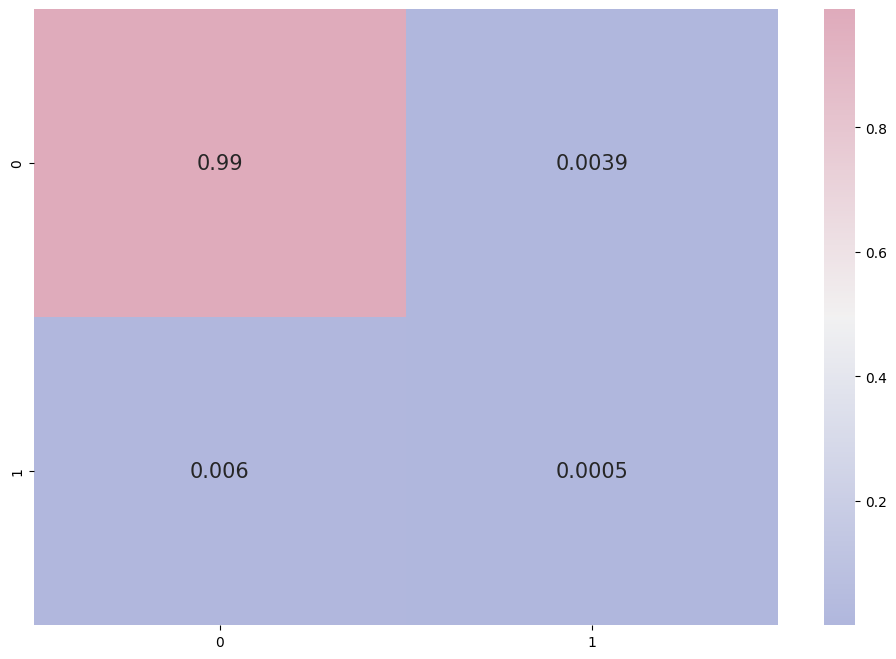

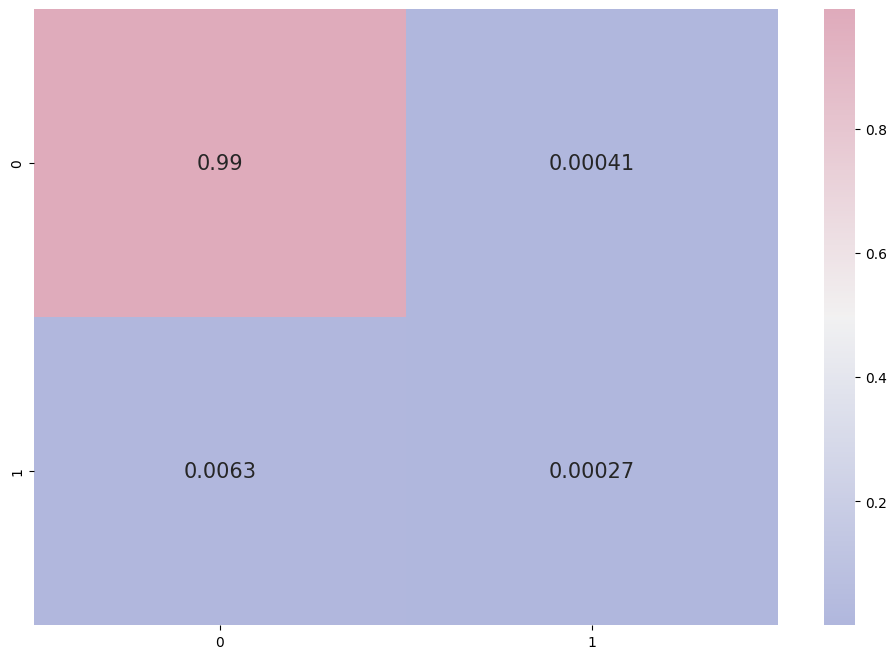

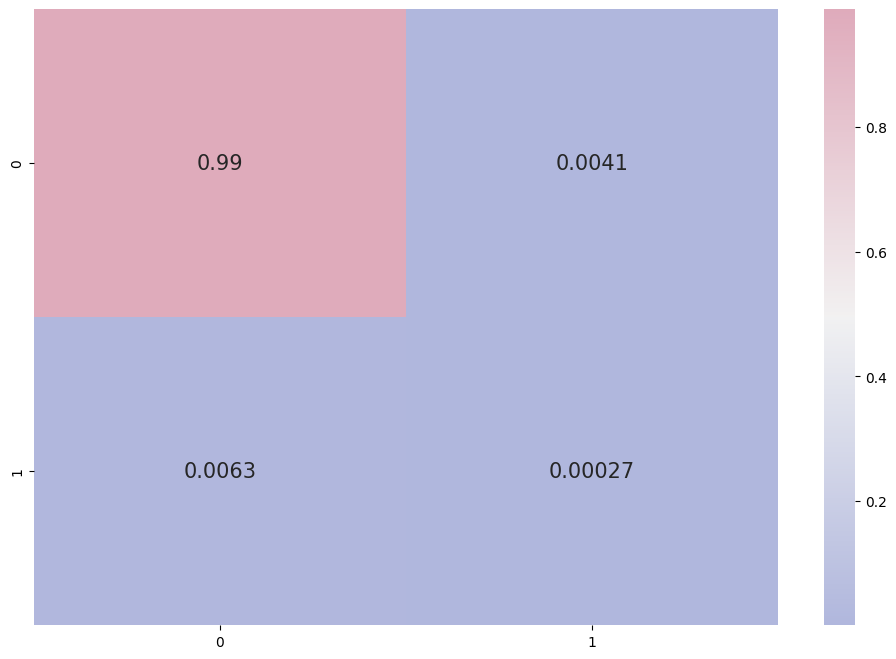

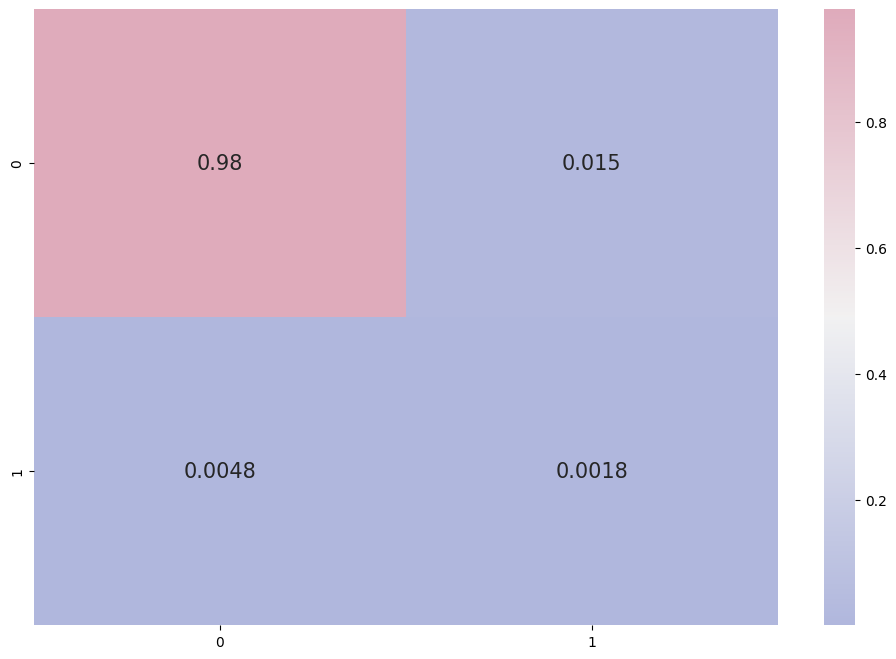

In [47]:
#last
classSuper(train_set2,test_set2)

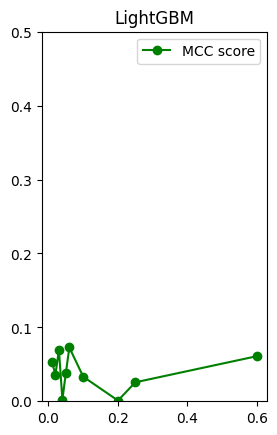

In [48]:
#learning curve
model = lgb.LGBMClassifier()
title1 = "LightGBM"
plt.subplot(121)
x,y=train_set2.shape
train_sizes=[0.01,0.02,0.03,0.04,0.05,0.06,0.1,0.2,0.25,0.6]
mccList=[]
plt.title(title1)
ylim=[0.0,0.5]
if ylim is not None:
    plt.ylim(*ylim)
for size in train_sizes:
    row=int(size*x)
    train_set  = train_set2[-row:]
    clf = model.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre=clf.predict(test_set2.iloc[:,0:y-1])
    y_tru=test_set2.iloc[:,y-1]
    #compute metric
    mcc=matthews_corrcoef(y_tru, y_pre)
    mccList.append(mcc)
        

plt.plot(train_sizes, mccList, "o-", color="green", label="MCC score")
plt.legend(loc="best")
plt.show()

In [57]:
train_set22,test_set22=getRandomSplit(train_set2, 0.1315)
train_set22

145487 22029


,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
9485,-1.221364,-0.467520,0.199071,0.073078,-0.216042,0.379250,0.167408,0
34235,-0.863736,-0.464037,0.220579,0.059313,-0.216042,0.456089,0.179328,0
40459,-0.730984,-0.471012,0.507246,0.114374,-0.216042,1.040868,0.383374,0
175160,0.825791,-0.500838,0.455139,-0.381173,0.693024,-0.686094,0.208093,0
128906,-1.731148,-0.502198,0.077653,-0.381173,0.693024,-0.862654,0.171916,0
...,...,...,...,...,...,...,...,...
168763,0.189018,-0.494714,-0.753138,-0.381173,0.693024,-0.540316,0.464185,0
66618,-0.447244,-0.461585,0.364264,0.100609,-0.216042,-0.676987,-0.205310,0
116832,0.257218,2.092059,-1.747410,-0.381173,-2.034174,1.295177,0.309619,0
89880,0.551899,-0.486641,0.876419,0.527329,-0.216042,1.191331,0.416581,0


lightgbm
acc: 0.9994098688092968
balanced acc: 0.9741941978585156
precision: 0.9764705882352941
recall: 0.9485714285714286
cm: [[21850     4]
 [    9   166]]
f1: 0.9623188405797102
MCC: 0.9621241577626687
Kappa: 0.9620215091694787
GradientBoosting
acc: 0.9979572381860276
balanced acc: 0.8827656264299442
precision: 0.9710144927536232
recall: 0.7657142857142857
cm: [[21850     4]
 [   41   134]]
f1: 0.8562300319488818
MCC: 0.8613409113679349
Kappa: 0.8552158190634805
catboost
Learning rate set to 0.086389
0:	learn: 0.4324613	total: 16.3ms	remaining: 16.3s
1:	learn: 0.2596417	total: 29.7ms	remaining: 14.8s
2:	learn: 0.1645538	total: 48.2ms	remaining: 16s
3:	learn: 0.1066421	total: 60.7ms	remaining: 15.1s
4:	learn: 0.0730816	total: 76.6ms	remaining: 15.3s
5:	learn: 0.0524388	total: 91.9ms	remaining: 15.2s
6:	learn: 0.0396700	total: 108ms	remaining: 15.3s
7:	learn: 0.0298340	total: 123ms	remaining: 15.3s
8:	learn: 0.0246604	total: 141ms	remaining: 15.5s
9:	learn: 0.0211729	total: 156ms	rema

156:	learn: 0.0026386	total: 2.13s	remaining: 11.4s
157:	learn: 0.0026197	total: 2.15s	remaining: 11.4s
158:	learn: 0.0026111	total: 2.16s	remaining: 11.4s
159:	learn: 0.0025939	total: 2.17s	remaining: 11.4s
160:	learn: 0.0025915	total: 2.19s	remaining: 11.4s
161:	learn: 0.0025909	total: 2.2s	remaining: 11.4s
162:	learn: 0.0025558	total: 2.22s	remaining: 11.4s
163:	learn: 0.0025450	total: 2.23s	remaining: 11.4s
164:	learn: 0.0025417	total: 2.24s	remaining: 11.4s
165:	learn: 0.0025395	total: 2.26s	remaining: 11.4s
166:	learn: 0.0025095	total: 2.28s	remaining: 11.4s
167:	learn: 0.0025089	total: 2.29s	remaining: 11.3s
168:	learn: 0.0025059	total: 2.3s	remaining: 11.3s
169:	learn: 0.0025052	total: 2.32s	remaining: 11.3s
170:	learn: 0.0025033	total: 2.33s	remaining: 11.3s
171:	learn: 0.0024944	total: 2.35s	remaining: 11.3s
172:	learn: 0.0024896	total: 2.37s	remaining: 11.3s
173:	learn: 0.0024870	total: 2.38s	remaining: 11.3s
174:	learn: 0.0024853	total: 2.39s	remaining: 11.3s
175:	learn: 0.

319:	learn: 0.0015372	total: 4.36s	remaining: 9.27s
320:	learn: 0.0015344	total: 4.38s	remaining: 9.26s
321:	learn: 0.0015300	total: 4.39s	remaining: 9.25s
322:	learn: 0.0015283	total: 4.41s	remaining: 9.24s
323:	learn: 0.0015259	total: 4.42s	remaining: 9.22s
324:	learn: 0.0015206	total: 4.43s	remaining: 9.21s
325:	learn: 0.0015182	total: 4.44s	remaining: 9.19s
326:	learn: 0.0014952	total: 4.46s	remaining: 9.17s
327:	learn: 0.0014929	total: 4.47s	remaining: 9.16s
328:	learn: 0.0014913	total: 4.48s	remaining: 9.13s
329:	learn: 0.0014898	total: 4.49s	remaining: 9.11s
330:	learn: 0.0014875	total: 4.5s	remaining: 9.1s
331:	learn: 0.0014860	total: 4.51s	remaining: 9.08s
332:	learn: 0.0014837	total: 4.53s	remaining: 9.07s
333:	learn: 0.0014816	total: 4.54s	remaining: 9.05s
334:	learn: 0.0014800	total: 4.55s	remaining: 9.03s
335:	learn: 0.0014760	total: 4.56s	remaining: 9.01s
336:	learn: 0.0014651	total: 4.57s	remaining: 9s
337:	learn: 0.0014635	total: 4.58s	remaining: 8.98s
338:	learn: 0.001

495:	learn: 0.0010125	total: 6.4s	remaining: 6.5s
496:	learn: 0.0010065	total: 6.41s	remaining: 6.49s
497:	learn: 0.0009935	total: 6.42s	remaining: 6.48s
498:	learn: 0.0009935	total: 6.43s	remaining: 6.46s
499:	learn: 0.0009918	total: 6.44s	remaining: 6.44s
500:	learn: 0.0009908	total: 6.46s	remaining: 6.43s
501:	learn: 0.0009859	total: 6.47s	remaining: 6.42s
502:	learn: 0.0009758	total: 6.48s	remaining: 6.4s
503:	learn: 0.0009723	total: 6.49s	remaining: 6.39s
504:	learn: 0.0009710	total: 6.5s	remaining: 6.37s
505:	learn: 0.0009683	total: 6.51s	remaining: 6.36s
506:	learn: 0.0009678	total: 6.52s	remaining: 6.34s
507:	learn: 0.0009676	total: 6.53s	remaining: 6.33s
508:	learn: 0.0009643	total: 6.54s	remaining: 6.31s
509:	learn: 0.0009642	total: 6.56s	remaining: 6.3s
510:	learn: 0.0009640	total: 6.57s	remaining: 6.29s
511:	learn: 0.0009638	total: 6.58s	remaining: 6.27s
512:	learn: 0.0009597	total: 6.59s	remaining: 6.26s
513:	learn: 0.0009596	total: 6.6s	remaining: 6.24s
514:	learn: 0.0009

675:	learn: 0.0008573	total: 8.05s	remaining: 3.86s
676:	learn: 0.0008568	total: 8.06s	remaining: 3.85s
677:	learn: 0.0008560	total: 8.08s	remaining: 3.84s
678:	learn: 0.0008560	total: 8.09s	remaining: 3.82s
679:	learn: 0.0008560	total: 8.1s	remaining: 3.81s
680:	learn: 0.0008560	total: 8.11s	remaining: 3.8s
681:	learn: 0.0008560	total: 8.11s	remaining: 3.78s
682:	learn: 0.0008560	total: 8.12s	remaining: 3.77s
683:	learn: 0.0008560	total: 8.13s	remaining: 3.75s
684:	learn: 0.0008560	total: 8.14s	remaining: 3.74s
685:	learn: 0.0008560	total: 8.14s	remaining: 3.73s
686:	learn: 0.0008560	total: 8.15s	remaining: 3.71s
687:	learn: 0.0008560	total: 8.16s	remaining: 3.7s
688:	learn: 0.0008560	total: 8.17s	remaining: 3.69s
689:	learn: 0.0008560	total: 8.17s	remaining: 3.67s
690:	learn: 0.0008560	total: 8.18s	remaining: 3.66s
691:	learn: 0.0008560	total: 8.19s	remaining: 3.64s
692:	learn: 0.0008560	total: 8.2s	remaining: 3.63s
693:	learn: 0.0008560	total: 8.2s	remaining: 3.62s
694:	learn: 0.000

842:	learn: 0.0007376	total: 9.66s	remaining: 1.8s
843:	learn: 0.0007376	total: 9.68s	remaining: 1.79s
844:	learn: 0.0007376	total: 9.68s	remaining: 1.78s
845:	learn: 0.0007376	total: 9.7s	remaining: 1.76s
846:	learn: 0.0007376	total: 9.7s	remaining: 1.75s
847:	learn: 0.0007376	total: 9.71s	remaining: 1.74s
848:	learn: 0.0007376	total: 9.72s	remaining: 1.73s
849:	learn: 0.0007376	total: 9.73s	remaining: 1.72s
850:	learn: 0.0007376	total: 9.74s	remaining: 1.71s
851:	learn: 0.0007376	total: 9.75s	remaining: 1.69s
852:	learn: 0.0007376	total: 9.76s	remaining: 1.68s
853:	learn: 0.0007376	total: 9.77s	remaining: 1.67s
854:	learn: 0.0007376	total: 9.78s	remaining: 1.66s
855:	learn: 0.0007376	total: 9.79s	remaining: 1.65s
856:	learn: 0.0007376	total: 9.8s	remaining: 1.64s
857:	learn: 0.0007376	total: 9.81s	remaining: 1.62s
858:	learn: 0.0007376	total: 9.82s	remaining: 1.61s
859:	learn: 0.0007376	total: 9.83s	remaining: 1.6s
860:	learn: 0.0007376	total: 9.84s	remaining: 1.59s
861:	learn: 0.000

acc: 0.9996822370511599
balanced acc: 0.9828342637503432
precision: 0.9941176470588236
recall: 0.9657142857142857
cm: [[21853     1]
 [    6   169]]
f1: 0.9797101449275363
MCC: 0.9796545623031073
Kappa: 0.97955004339895


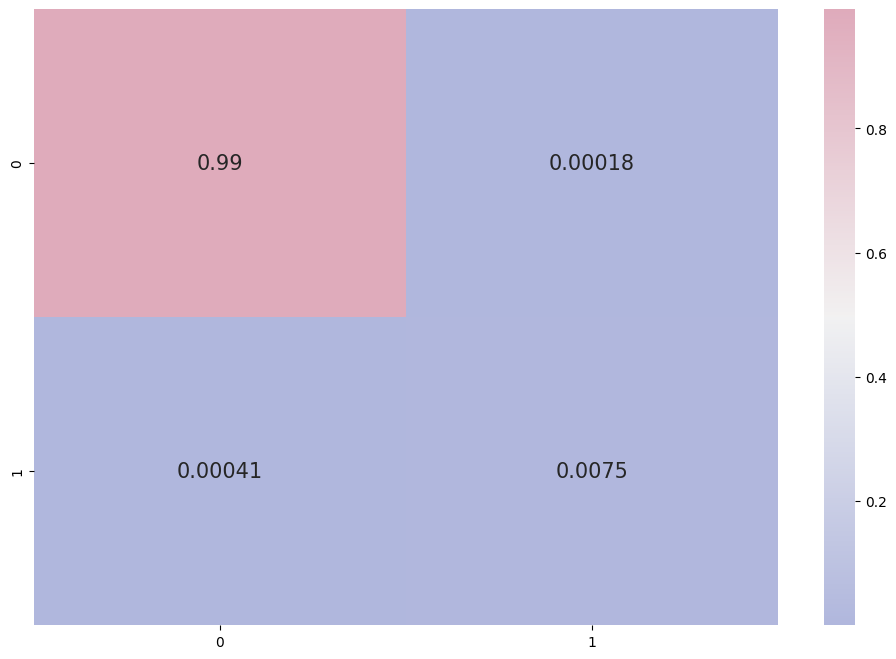

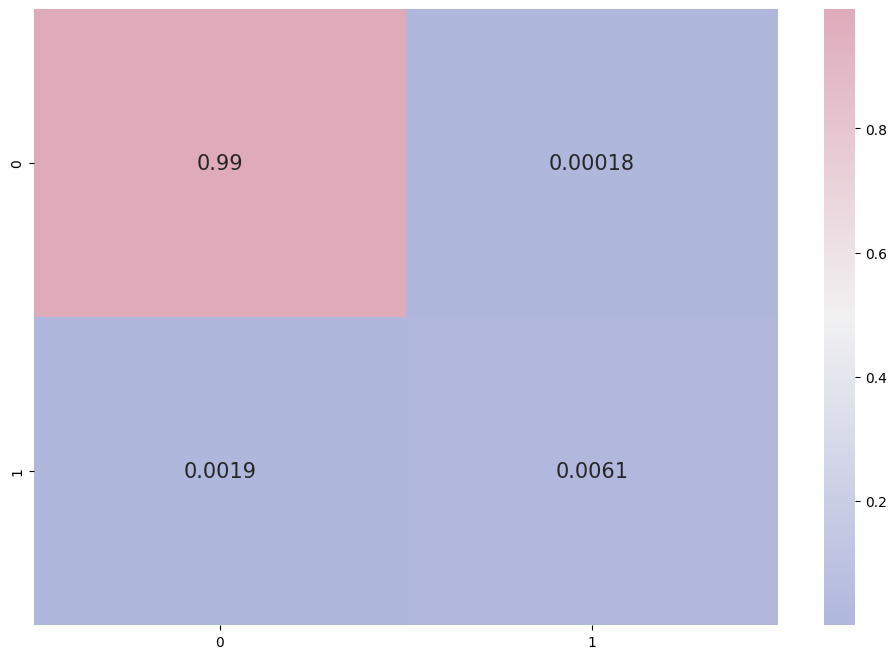

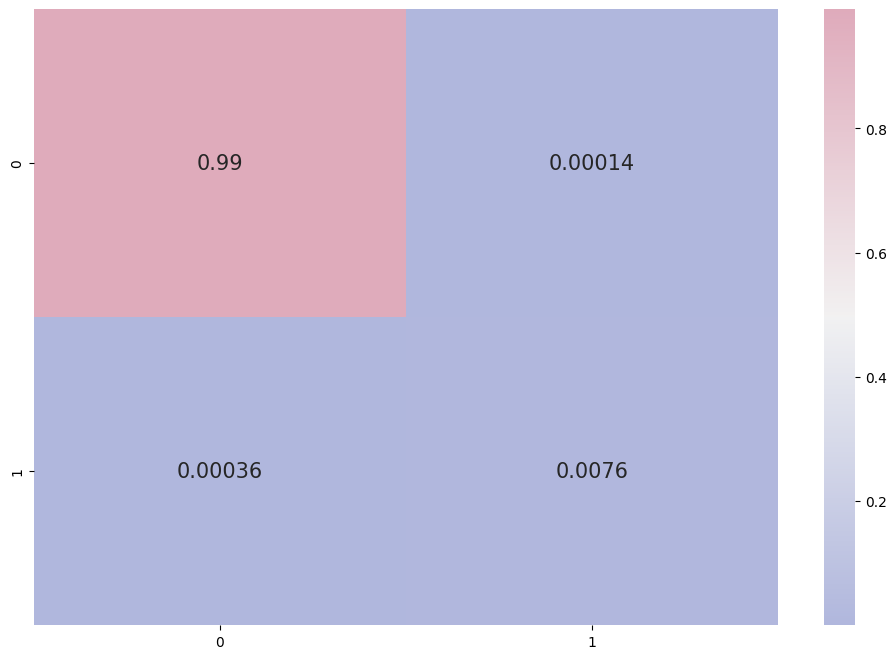

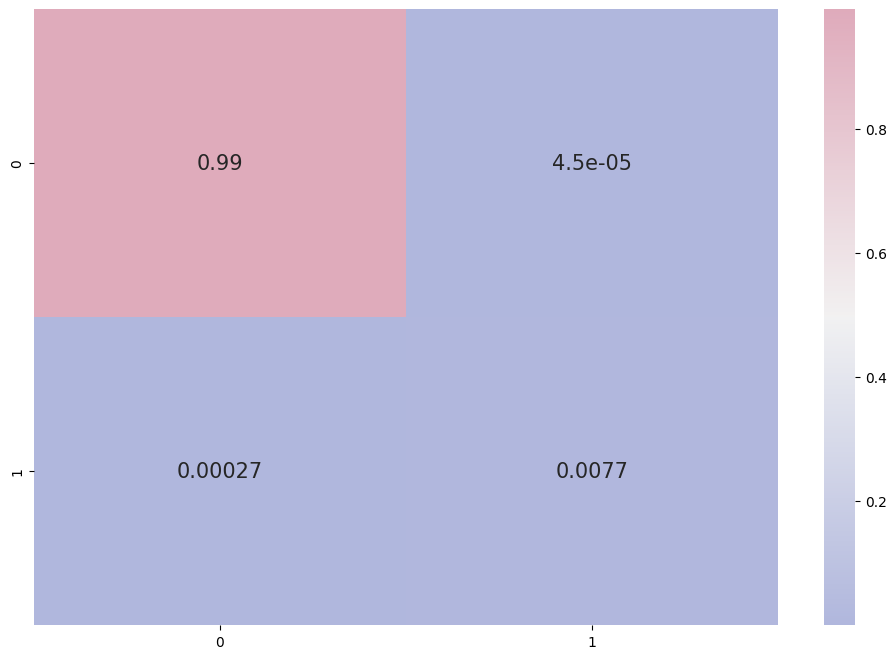

In [58]:
#random
classSuper(train_set22,test_set22)

lightgbm
acc: 0.9925660668147409
balanced acc: 0.5167907775800622
precision: 0.16666666666666666
recall: 0.034722222222222224
cm: [[21892    25]
 [  139     5]]
f1: 0.057471264367816084
MCC: 0.07338290019529133
Kappa: 0.05534502322992285
GradientBoosting
acc: 0.9924754090929695
balanced acc: 0.5167451508975782
precision: 0.15625
recall: 0.034722222222222224
cm: [[21890    27]
 [  139     5]]
f1: 0.05681818181818182
MCC: 0.07086282803282866
Kappa: 0.05457413412090295
catboost
Learning rate set to 0.086389
0:	learn: 0.4324613	total: 11.9ms	remaining: 11.9s
1:	learn: 0.2596417	total: 22.6ms	remaining: 11.3s
2:	learn: 0.1645538	total: 33.2ms	remaining: 11s
3:	learn: 0.1066421	total: 44.4ms	remaining: 11.1s
4:	learn: 0.0730816	total: 55.6ms	remaining: 11.1s
5:	learn: 0.0524388	total: 66.8ms	remaining: 11.1s
6:	learn: 0.0396700	total: 78.5ms	remaining: 11.1s
7:	learn: 0.0298340	total: 91.1ms	remaining: 11.3s
8:	learn: 0.0246604	total: 107ms	remaining: 11.8s
9:	learn: 0.0211729	total: 121ms	r

161:	learn: 0.0025909	total: 1.94s	remaining: 10s
162:	learn: 0.0025558	total: 1.95s	remaining: 10s
163:	learn: 0.0025450	total: 1.96s	remaining: 10s
164:	learn: 0.0025417	total: 1.98s	remaining: 9.99s
165:	learn: 0.0025395	total: 1.99s	remaining: 9.98s
166:	learn: 0.0025095	total: 2s	remaining: 9.96s
167:	learn: 0.0025089	total: 2.01s	remaining: 9.94s
168:	learn: 0.0025059	total: 2.02s	remaining: 9.92s
169:	learn: 0.0025052	total: 2.03s	remaining: 9.9s
170:	learn: 0.0025033	total: 2.04s	remaining: 9.89s
171:	learn: 0.0024944	total: 2.05s	remaining: 9.87s
172:	learn: 0.0024896	total: 2.06s	remaining: 9.86s
173:	learn: 0.0024870	total: 2.07s	remaining: 9.84s
174:	learn: 0.0024853	total: 2.08s	remaining: 9.82s
175:	learn: 0.0024596	total: 2.1s	remaining: 9.81s
176:	learn: 0.0024539	total: 2.11s	remaining: 9.8s
177:	learn: 0.0024448	total: 2.12s	remaining: 9.78s
178:	learn: 0.0024406	total: 2.13s	remaining: 9.77s
179:	learn: 0.0024392	total: 2.14s	remaining: 9.75s
180:	learn: 0.0024319	to

328:	learn: 0.0014913	total: 4s	remaining: 8.15s
329:	learn: 0.0014898	total: 4.01s	remaining: 8.13s
330:	learn: 0.0014875	total: 4.02s	remaining: 8.12s
331:	learn: 0.0014860	total: 4.03s	remaining: 8.11s
332:	learn: 0.0014837	total: 4.04s	remaining: 8.09s
333:	learn: 0.0014816	total: 4.05s	remaining: 8.08s
334:	learn: 0.0014800	total: 4.07s	remaining: 8.07s
335:	learn: 0.0014760	total: 4.08s	remaining: 8.06s
336:	learn: 0.0014651	total: 4.09s	remaining: 8.05s
337:	learn: 0.0014635	total: 4.11s	remaining: 8.04s
338:	learn: 0.0014535	total: 4.12s	remaining: 8.03s
339:	learn: 0.0014520	total: 4.13s	remaining: 8.02s
340:	learn: 0.0014499	total: 4.15s	remaining: 8.01s
341:	learn: 0.0014437	total: 4.16s	remaining: 8.01s
342:	learn: 0.0014425	total: 4.17s	remaining: 7.99s
343:	learn: 0.0014424	total: 4.18s	remaining: 7.98s
344:	learn: 0.0014321	total: 4.2s	remaining: 7.97s
345:	learn: 0.0014138	total: 4.21s	remaining: 7.96s
346:	learn: 0.0014125	total: 4.22s	remaining: 7.95s
347:	learn: 0.00

497:	learn: 0.0009935	total: 6.06s	remaining: 6.11s
498:	learn: 0.0009935	total: 6.06s	remaining: 6.09s
499:	learn: 0.0009918	total: 6.08s	remaining: 6.08s
500:	learn: 0.0009908	total: 6.09s	remaining: 6.06s
501:	learn: 0.0009859	total: 6.1s	remaining: 6.05s
502:	learn: 0.0009758	total: 6.11s	remaining: 6.04s
503:	learn: 0.0009723	total: 6.13s	remaining: 6.03s
504:	learn: 0.0009710	total: 6.14s	remaining: 6.02s
505:	learn: 0.0009683	total: 6.15s	remaining: 6s
506:	learn: 0.0009678	total: 6.16s	remaining: 5.99s
507:	learn: 0.0009676	total: 6.17s	remaining: 5.98s
508:	learn: 0.0009643	total: 6.18s	remaining: 5.96s
509:	learn: 0.0009642	total: 6.19s	remaining: 5.95s
510:	learn: 0.0009640	total: 6.2s	remaining: 5.94s
511:	learn: 0.0009638	total: 6.21s	remaining: 5.92s
512:	learn: 0.0009597	total: 6.23s	remaining: 5.91s
513:	learn: 0.0009596	total: 6.24s	remaining: 5.9s
514:	learn: 0.0009590	total: 6.25s	remaining: 5.88s
515:	learn: 0.0009571	total: 6.26s	remaining: 5.87s
516:	learn: 0.0009

667:	learn: 0.0008610	total: 7.67s	remaining: 3.81s
668:	learn: 0.0008610	total: 7.68s	remaining: 3.8s
669:	learn: 0.0008610	total: 7.68s	remaining: 3.79s
670:	learn: 0.0008610	total: 7.69s	remaining: 3.77s
671:	learn: 0.0008610	total: 7.7s	remaining: 3.76s
672:	learn: 0.0008573	total: 7.71s	remaining: 3.75s
673:	learn: 0.0008573	total: 7.72s	remaining: 3.73s
674:	learn: 0.0008573	total: 7.72s	remaining: 3.72s
675:	learn: 0.0008573	total: 7.73s	remaining: 3.71s
676:	learn: 0.0008568	total: 7.74s	remaining: 3.69s
677:	learn: 0.0008560	total: 7.75s	remaining: 3.68s
678:	learn: 0.0008560	total: 7.76s	remaining: 3.67s
679:	learn: 0.0008560	total: 7.77s	remaining: 3.65s
680:	learn: 0.0008560	total: 7.77s	remaining: 3.64s
681:	learn: 0.0008560	total: 7.78s	remaining: 3.63s
682:	learn: 0.0008560	total: 7.79s	remaining: 3.61s
683:	learn: 0.0008560	total: 7.79s	remaining: 3.6s
684:	learn: 0.0008560	total: 7.8s	remaining: 3.59s
685:	learn: 0.0008560	total: 7.8s	remaining: 3.57s
686:	learn: 0.000

845:	learn: 0.0007376	total: 9.28s	remaining: 1.69s
846:	learn: 0.0007376	total: 9.29s	remaining: 1.68s
847:	learn: 0.0007376	total: 9.3s	remaining: 1.67s
848:	learn: 0.0007376	total: 9.31s	remaining: 1.66s
849:	learn: 0.0007376	total: 9.32s	remaining: 1.64s
850:	learn: 0.0007376	total: 9.32s	remaining: 1.63s
851:	learn: 0.0007376	total: 9.33s	remaining: 1.62s
852:	learn: 0.0007376	total: 9.34s	remaining: 1.61s
853:	learn: 0.0007376	total: 9.34s	remaining: 1.6s
854:	learn: 0.0007376	total: 9.35s	remaining: 1.59s
855:	learn: 0.0007376	total: 9.36s	remaining: 1.57s
856:	learn: 0.0007376	total: 9.37s	remaining: 1.56s
857:	learn: 0.0007376	total: 9.38s	remaining: 1.55s
858:	learn: 0.0007376	total: 9.38s	remaining: 1.54s
859:	learn: 0.0007376	total: 9.39s	remaining: 1.53s
860:	learn: 0.0007376	total: 9.4s	remaining: 1.52s
861:	learn: 0.0007376	total: 9.41s	remaining: 1.5s
862:	learn: 0.0007376	total: 9.41s	remaining: 1.49s
863:	learn: 0.0007376	total: 9.42s	remaining: 1.48s
864:	learn: 0.00

acc: 0.9804632609582521
balanced acc: 0.624530108540808
precision: 0.1046831955922865
recall: 0.2638888888888889
cm: [[21592   325]
 [  106    38]]
f1: 0.14990138067061146
MCC: 0.1576569052307588
Kappa: 0.14188065520839843


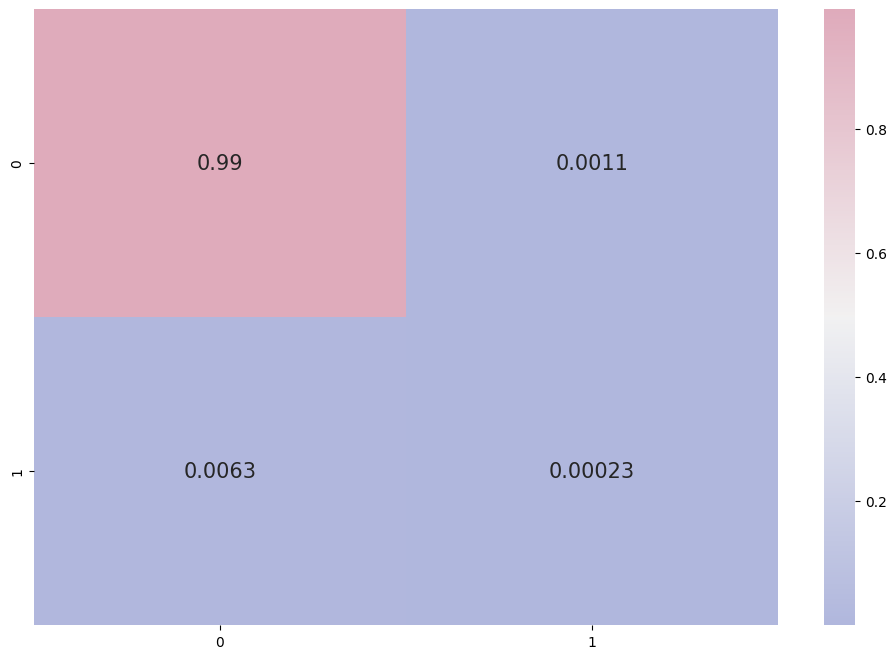

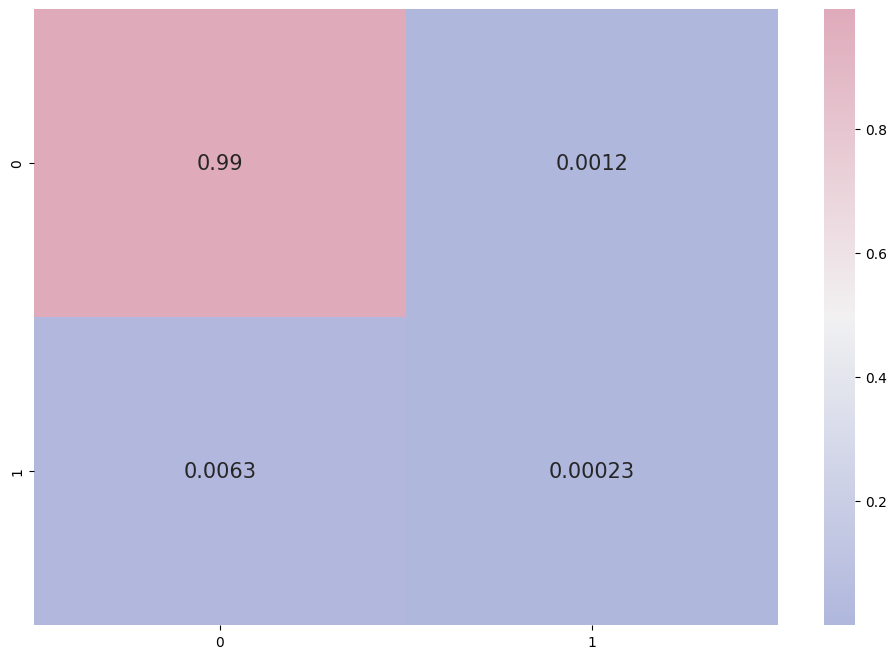

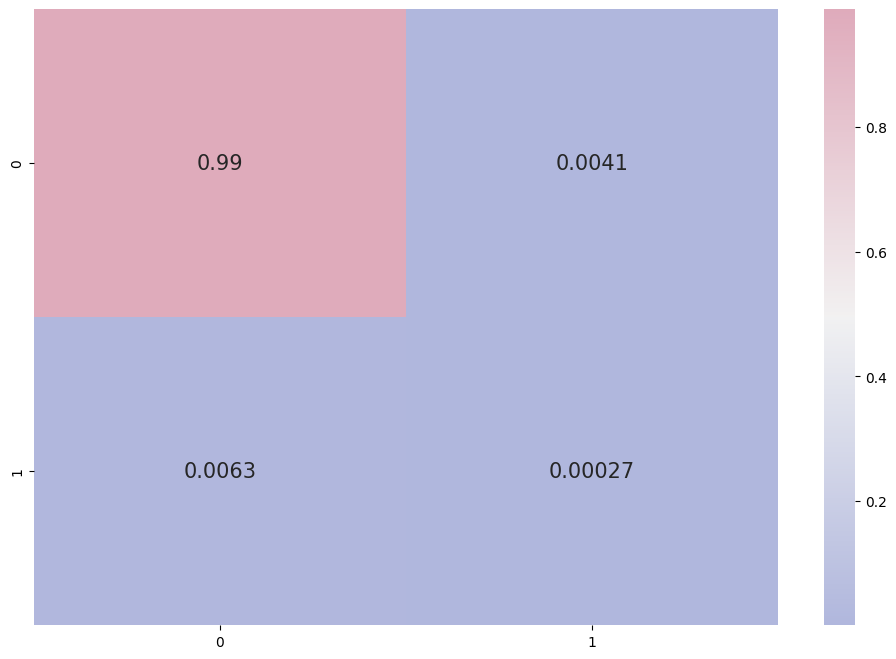

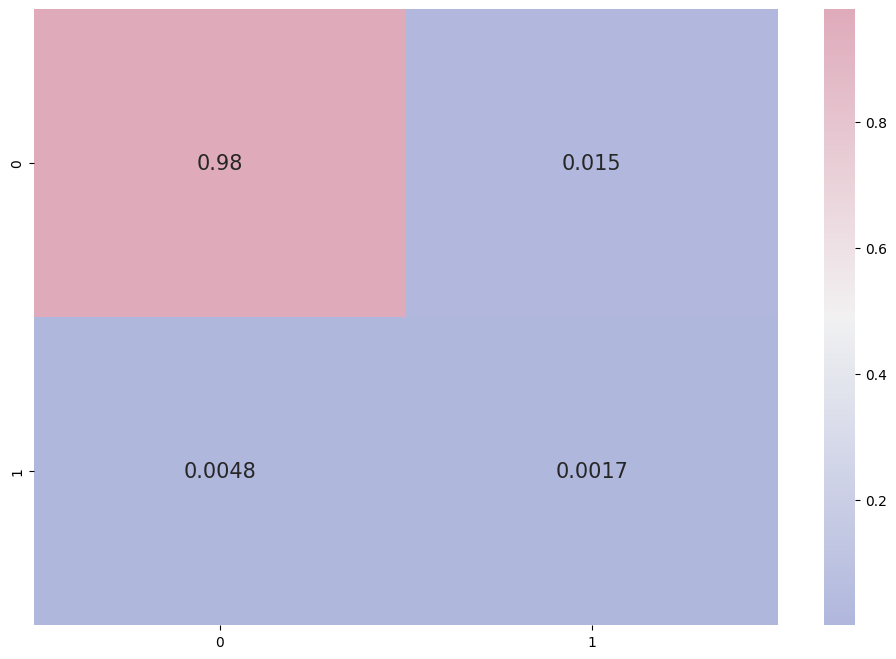

In [59]:
classSuper(train_set22,test_set2)

In [60]:
test_set22

,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
19311,-0.986933,-0.465172,0.456418,0.128139,-0.216042,-1.113343,-0.321845,0
13186,-1.084746,-0.454034,0.136488,0.155669,-0.216042,-1.324383,-0.410495,0
1476,-1.718821,-0.461683,0.578623,0.108852,-0.216042,-1.015325,-0.261539,0
68226,-0.448849,-0.483807,0.775597,0.114374,-0.216042,-0.593499,-0.148994,0
39132,-0.731057,2.102790,0.507037,0.499799,-0.216042,0.746039,0.466153,0
...,...,...,...,...,...,...,...,...
75670,-0.092387,-0.495574,1.314060,1.010461,-3.852306,1.118787,0.164058,0
46943,-0.732369,-0.479818,1.717826,0.912755,-0.216042,1.053452,0.467185,0
14873,-1.086059,-0.461618,0.133632,0.031783,-0.216042,-1.281385,-0.393351,0
147947,-0.455997,-0.479331,-0.371710,-0.381173,0.693024,-0.740301,-1.814197,0
